# Лабораторная работа №6. Дискретное косинусное преобразование 

### Лодочникова Владлена. Группа №5130901/10202

### Упражнение 6.1 

Утверждается, что analyze1 требует времени пропорционально n^3, а analyze2 - пропорционально n^2. Убедимся в этом, запуская их с несколькими разными массивами и засекая время работы.В блокнотах Jupyter можно использовать "волшебную команду" %timeit.

Если печатать зависимость времени работы от размера на логарифмической шкале, то получится прямая линия с уклоном 3 для analyze1 и с уклоном 2 для analyze2.

Также поупражняемся с dct_iv и scipy.fftpack.dct.

Для начала возьмем шумовой сигнал.

In [16]:
from thinkdsp import UncorrelatedGaussianNoise

signal = UncorrelatedGaussianNoise()
noise = signal.make_wave(duration=1.0, framerate=16384)
noise.ys.shape

(16384,)

Затем создадим функцию, которая берет массив результатов из эксперимента по синхронизации, строит график результатов и помещает их в прямую линию. 

In [17]:
from matplotlib import pyplot as plt
from scipy.stats import linregress

from thinkdsp import decorate

loglog = dict(xscale='log', yscale='log')

def plot_bests(ns, bests):    
    plt.plot(ns, bests)
    decorate(**loglog)
    
    x = np.log(ns)
    y = np.log(bests)
    t = linregress(x,y)
    slope = t[0]

    return slope

In [18]:
import numpy as np


PI2 = np.pi * 2

def analyze1(ys, fs, ts):
    """Analyze a mixture of cosines and return amplitudes.

    Works for the general case where M is not orthogonal.

    ys: wave array
    fs: frequencies in Hz
    ts: times where the signal was evaluated    

    returns: vector of amplitudes
    """
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.linalg.solve(M, ys)
    return amps

In [19]:
def run_speed_test(ns, func):
    results = []
    for N in ns:
        print(N)
        ts = (0.5 + np.arange(N)) / N
        freqs = (0.5 + np.arange(N)) / 2
        ys = noise.ys[:N]
        result = %timeit -r1 -o func(ys, freqs, ts)
        results.append(result)
        
    bests = [result.best for result in results]
    return bests

Проведем тестирование. 

Сначала представим результаты для analyze1:

In [20]:
ns = 2 ** np.arange(6, 13)
ns

array([  64,  128,  256,  512, 1024, 2048, 4096], dtype=int32)

64


499 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
128
1.58 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
256
8.58 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
512
35 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
1024
233 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
2048
1.24 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
4096
7.95 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


2.3522497680686594

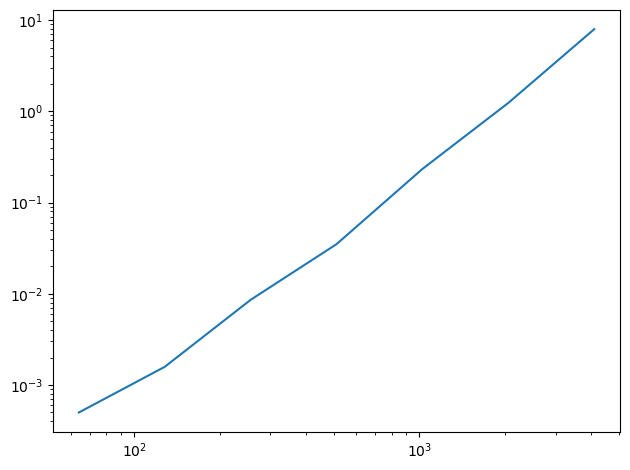

In [21]:
import numpy as np

bests = run_speed_test(ns, analyze1)
plot_bests(ns, bests)

Наклон получился близок к степпни двойки, чем к степени тройки. Это могло произойти из-за того, что производительность np.linalg.solve почти квадратична в этом диапазоне размеров массива. При больших размерах массива, рост analyze1 будет пропорционален n3.

Далее проведем эксперемент для analyze2. 
Напишем функцию для analyze2:

In [22]:
def analyze2(ys, fs, ts):
    """Analyze a mixture of cosines and return amplitudes.

    Assumes that fs and ts are chosen so that M is orthogonal.

    ys: wave array
    fs: frequencies in Hz
    ts: times where the signal was evaluated    

    returns: vector of amplitudes
    """
    args = np.outer(ts, fs)
    M = np.cos(PI2 * args)
    amps = np.dot(M, ys) / 2
    return amps

И получим результаты для analyze2.

64
233 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
128
882 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
256
3.13 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
512
16.8 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
1024
66.4 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
2048
261 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
4096
906 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


2.02152815864345

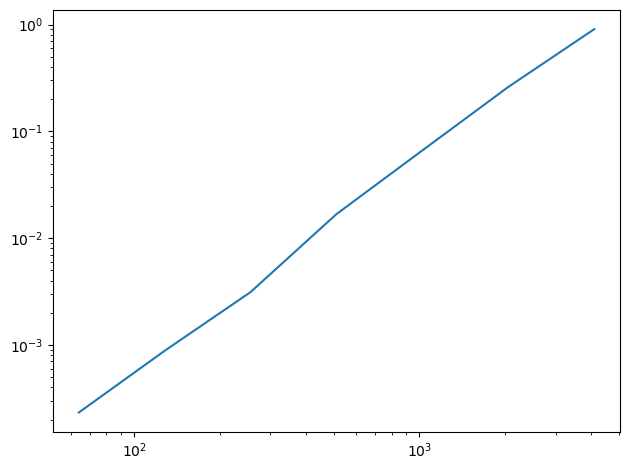

In [24]:
bests2 = run_speed_test(ns, analyze2)
plot_bests(ns, bests2)

Из графика видно, что analyze2  растет пропорционально степени 2, как и ожидалось. 


Исследование показало, что утверждение верно. 

Далее проведем тестирование scipy.fftpack.dct. 

64


47.3 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
128
52.4 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
256
44.8 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
512
51.2 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
1024
64.8 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
2048
92.9 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)
4096
155 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 10,000 loops each)


0.26117111088070327

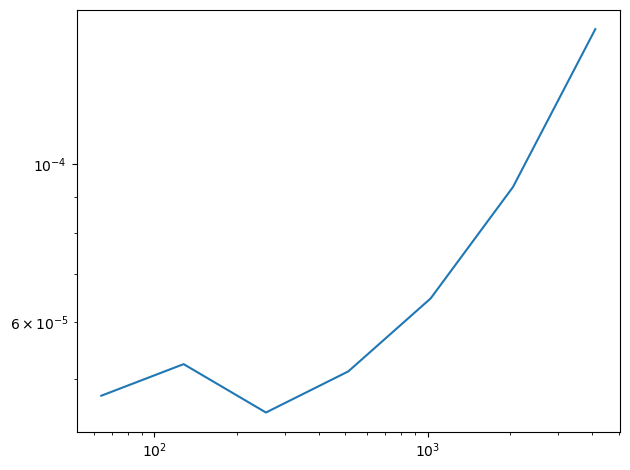

In [34]:
import scipy.fftpack

def scipy_dct(ys, freqs, ts):
    return scipy.fftpack.dct(ys, type=3)
    
bests3 = run_speed_test(ns, scipy_dct)
plot_bests(ns, bests3)

Как видно из графика, def scipy_dct намного быстрее. Время работы функции пропорционально N * log(N).

Далее проведем тестирование dct_iv.

In [36]:
def dct_iv(ys, freqs, ts):
  N = len(ys)
  ts = (0.5 + np.arange(N))/N
  fs = (0.5 + np.arange(N))/2
  args = np.outer(ts,fs)
  M = np.cos(PI2*args)
  amps = np.dot(M, ys) / 2
  return amps

64
296 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
128
974 µs ± 0 ns per loop (mean ± std. dev. of 1 run, 1,000 loops each)
256
3.05 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
512
16.9 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 100 loops each)
1024
66.1 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 10 loops each)
2048
246 ms ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)
4096
1.07 s ± 0 ns per loop (mean ± std. dev. of 1 run, 1 loop each)


1.9950420211188562

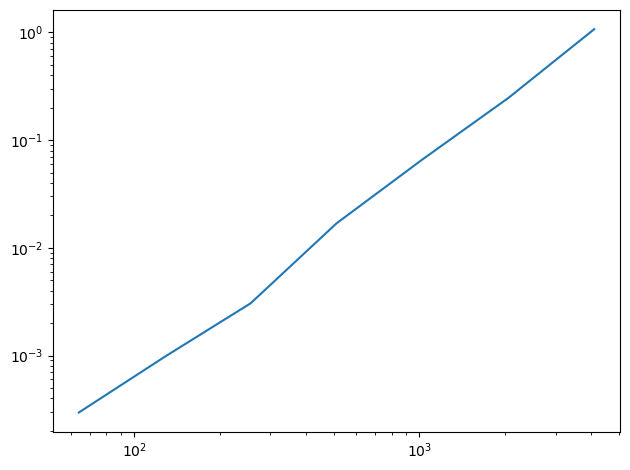

In [39]:
best4 = run_speed_test(ns, dct_iv)
plot_bests(ns, best4)

В результате анализа была получена кривая, которая имеет искривление и наклон примерно равный 1.995.

На следующем рисунке показаны четыре кривые на одних и тех же осях.

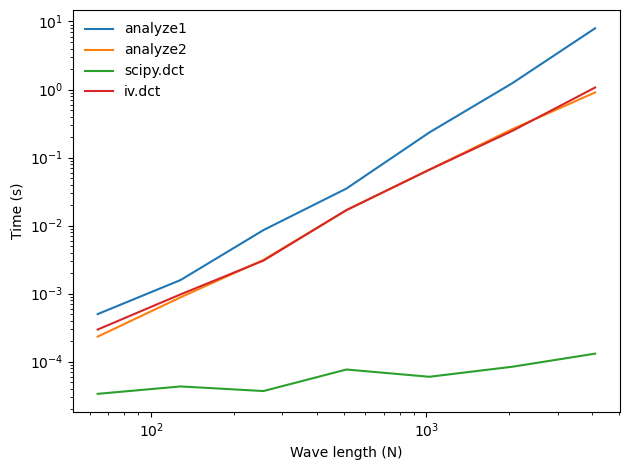

In [43]:
plt.plot(ns, bests, label='analyze1')
plt.plot(ns, bests2, label='analyze2')
plt.plot(ns, bests3, label='scipy.dct')
plt.plot(ns, best4, label='iv.dct')
decorate(xlabel='Wave length (N)', ylabel='Time (s)', **loglog)




# Упражнение 6.2

Одно из основных применений ДКП - сэатие звука и изображений. В простейшей форме ДКП при сжатии работает следующим образом: 
1. Разбивает длинный сигнал на сегменты.
2. Вьчисляет ДКП каждого сегмента.
3. Определяет частотные компоненты с такой амплитудой, что
их не слышно, и удаляет их, сохраняя только оставшиеся частоты
и амплитуды.
4. При воспроизведении сигнала загружает частоты и амплитуды
каждого сегмента и применяет обратное ДКП.

Реализуем версию этого алгоритма и применим его для записи
музыки или речи. 

Загрузим саму запись и послушаем. В качестве сжимаемого файла возьмем звук игры на пианино. 


In [40]:
from thinkdsp import read_wave

wave = read_wave('728195__josefpres__piano.wav')
wave.make_audio()

Выделим из записи короткий сегмент.

In [45]:
segment = wave.segment(start=0, duration=1)
segment.normalize()
segment.make_audio()

Построем DCT график для полученного сегмента.

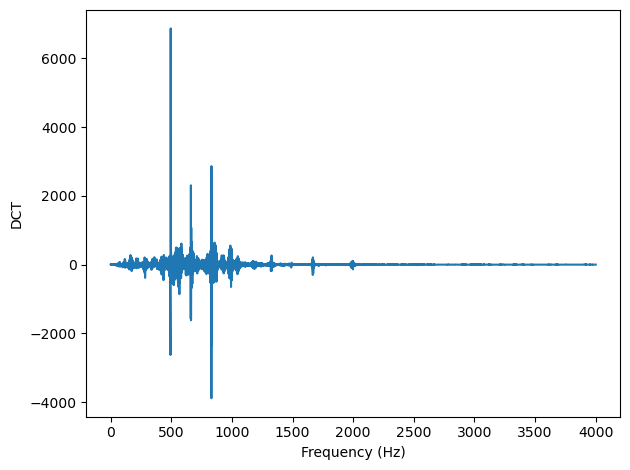

In [46]:
seg_dct = segment.make_dct()
seg_dct.plot(high=4000)
decorate(xlabel='Frequency (Hz)', ylabel='DCT')

Из графика видно, что есть немного частот с большой амплитудой. 

Создадим функцию, которая убирает из ДКП частоты со значениями ниже заданного treshold

In [47]:
def compress(dct, thresh=1):
    count = 0
    for i, amp in enumerate(dct.amps):
        if np.abs(amp) < thresh:
            dct.hs[i] = 0
            count += 1
            
    n = len(dct.amps)
    print(count, n, 100 * count / n, sep='\t')

Применим функцию для нашего сегмента. 

41581	44100	94.28798185941044


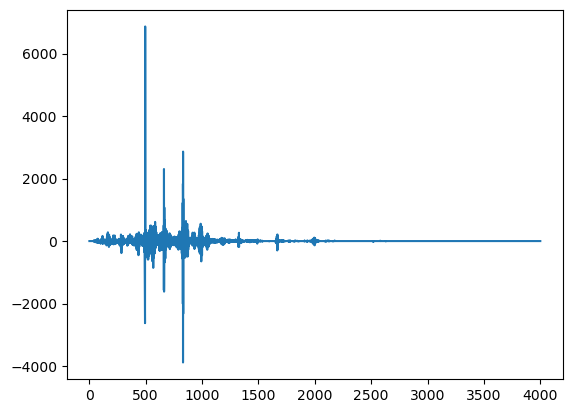

In [50]:
seg_dct = segment.make_dct()
compress(seg_dct, thresh=10)
seg_dct.plot(high=4000)

Прослушаем обработанный сигнал. 

In [51]:
seg2 = seg_dct.make_wave()
seg2.make_audio()

Звук остался практически неизменным при сжатии в 94%. Графики тоже очень похожи. 

# Упражнение 6.3

В репозитории есть блокнот jupyter под названием
phase.ipynb, в котором исследуется влияние фазы на восприятие
звука. Прочтите этот блокнот и "погоняйте" примеры. Выберите
иной сегмент звука и повторите эксперименты. Можно ли найти некие
общие соотношения в фазовой структуре звука и его восприятии?

Загрузим звук, который использовали в задание 6.2, и послушаем запись. 

In [52]:

wave = read_wave('728195__josefpres__piano.wav')
wave.make_audio()

Выделим из записи короткий сегмент.

In [53]:
segment = wave.segment(start=0, duration=1)
segment.normalize()
segment.make_audio()

Напишем функции для вывода амплитуды, углов и waveform заданного спектра.

In [54]:
def plot_angle(spectrum, thresh=1):
    angles = spectrum.angles
    angles[spectrum.amps < thresh] = np.nan
    plt.plot(spectrum.fs, angles, 'x')
    decorate(xlabel='Frequency (Hz)', 
             ylabel='Phase (radian)')

In [55]:
def plot_three(spectrum, thresh=1):
    plt.figure(figsize=(10, 4))
    plt.subplot(1,3,1)
    spectrum.plot()
    plt.subplot(1,3,2)
    plot_angle(spectrum, thresh=thresh)
    plt.subplot(1,3,3)
    wave = spectrum.make_wave()
    wave.unbias()
    wave.normalize()
    wave.segment(duration=0.01).plot()
    display(wave.make_audio())

Далее получим данные для оригинального сегмента

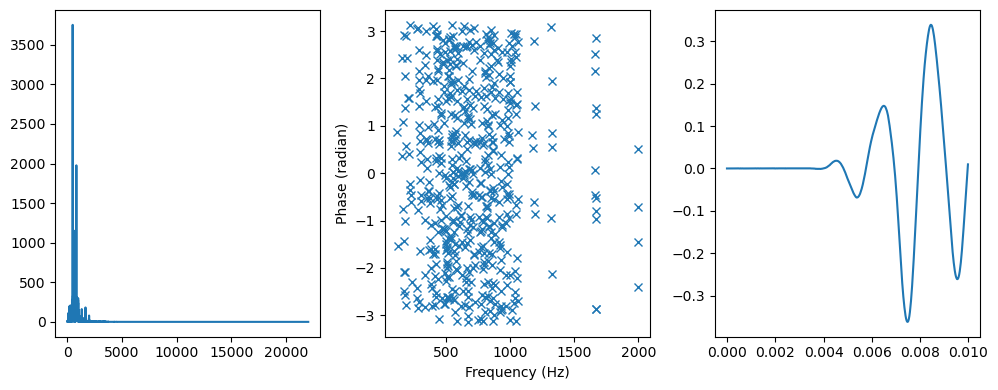

In [56]:
spectrum = segment.make_spectrum()
plot_three(spectrum, thresh=50)

Напишем функцию для обнуления всех углов сегмента. 

In [57]:
def zero_angle(spectrum):
    res = spectrum.copy()
    res.hs = res.amps
    return res

Используем ее.

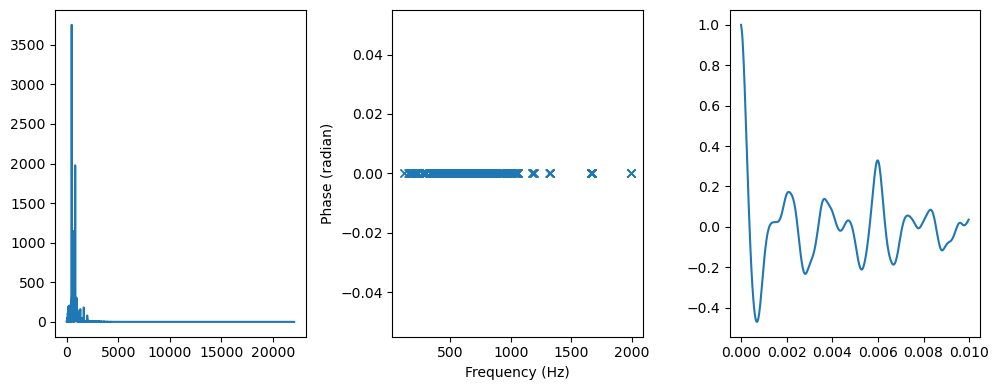

In [58]:
spectrum2 = zero_angle(spectrum)
plot_three(spectrum2, thresh=50)

После обнуления углов сегмент звучит намного тише. 

Теперь напишем функцию для поворота углов на 1 радиан.

In [59]:
def rotate_angle(spectrum, offset):
    res = spectrum.copy()
    res.hs *= np.exp(1j * offset)
    return res

Используем ее. 

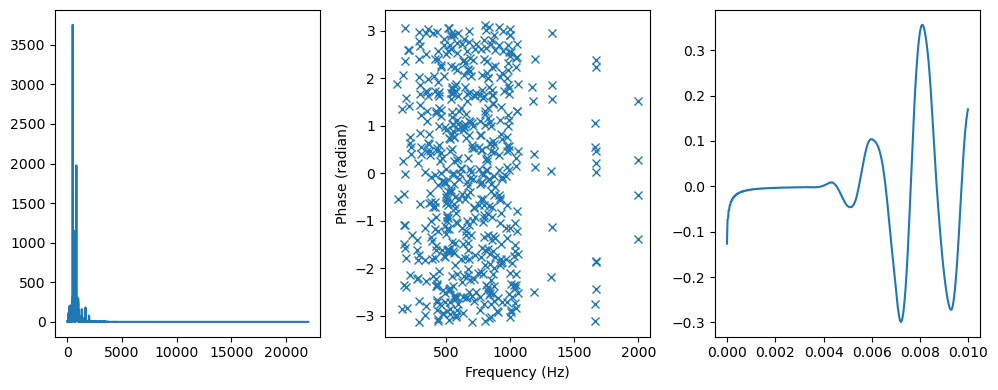

In [60]:
spectrum3 = rotate_angle(spectrum, 1)
plot_three(spectrum3, thresh=50)

После поворота углов сигнал кажется почти неизменным.

Создадим функцию для рандомизации углов. 

In [61]:
PI2 = np.pi * 2

def random_angle(spectrum):
    res = spectrum.copy()
    angles = np.random.uniform(0, PI2, len(spectrum))
    res.hs *= np.exp(1j * angles)
    return res

Используем ее. 